In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
from shapely.geometry import Point, MultiPolygon

In [3]:
import scanpy as sc
import pandas as pd
import scanpy as sc 
import sys 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import warnings
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt
import matplotlib as mpl

warnings.filterwarnings('ignore')
sys.path.append('../../src')

from spaceoracle.plotting.cartography import Cartography
import celloracle as co
from celloracle.applications import Gradient_calculator
from celloracle.applications.scatter_to_grid import scatter_value_to_grid_value
from celloracle.applications.differentiation_flow import get_gradient, normalize_gradient
from spaceoracle.virtual_tissue import VirtualTissue

%matplotlib inline

In [4]:
adata = sc.read_h5ad('/Volumes/SSD/training_data/snrna_human_tonsil.h5ad')
adata.obsm['X_umap'] = pd.read_csv('umap.csv', index_col=0).values
adata.obs = adata.obs.join(pd.read_csv('tonsil_cell_types.csv', index_col=0))

sc.pp.pca(adata)
sc.pp.neighbors(adata)

In [5]:
adata.layers['imputed_count'] = np.load('../../notebooks/human_tonsil/imputed_counts.npy')

In [6]:
import json

with open('./colors.json', 'r') as f:
    color_dict = json.load(f)

In [7]:
adata.obs['cell_type_major'] = adata.obs.cell_type_2.replace(
    {
        'GC Dark Zone': 'Germinal Center B cells', 
        'GC Light Zone': 'Germinal Center B cells', 
        'GC Intermediate Zone': 'Germinal Center B cells', 
        'plasma': 'Plasma cells', 
        'B_naive': 'B cells', 
        'B_memory': 'B cells', 
        'B_germinal_center': 'Germinal Center B cells', 
        'Naive CD4 T': 'T cells', 
        'Treg': 'T cells', 
        'T memory': 'T cells', 
        'Th1': 'T cells', 
        'Th2': 'T cells', 
        'T_CD8': 'T cells', 
        'T_follicular_helper': 'T cells', 
        'mDC': 'Dendritic cells', 
        'FDC': 'Dendritic cells', 
        'myeloid': 'Myeloid cells', 
        'NK': 'NK cells', 
        'pDC': 'Dendritic cells', 
        'T_double_neg': 'T cells'
    }
)

In [8]:
%matplotlib inline

figure_params = {
    'dpi': 300, 
    'bbox_inches': 'tight', 
    'format': 'svg', 
    'transparent': True
}

plt.rcParams.update({
    "text.usetex": False,
    "svg.fonttype": 'none'
})

In [9]:
# plt.rcParams['figure.figsize'] = (6, 6)

# import alphashape

# ct_points_wt = {}
# for ct in adata.obs['cell_type_2'].unique():
#     points = np.asarray(
#         adata[adata.obs['cell_type_2'] == ct].obsm['spatial'])
#     delta = 30
#     points = np.vstack(
#         (points +[-delta,delta], points +[-delta,-delta], 
#         points +[delta,delta], points +[delta,-delta]))
#     ct_points_wt[ct] = points

# # adatax = adata[~adata.obs.cell_type_major.isin([
# #     'Myeloid cells', 'Dendritic cells', 'NK cells'])]

# adatax = adata

# sns.scatterplot(data=adatax.obs, 
#     x=adatax.obsm['spatial'][:,0], 
#     y=adatax.obsm['spatial'][:,1],
#     s=15,
#     hue='cell_type_2',
#     legend='brief', palette=color_dict)
# plt.axis('off')


# plt.legend(bbox_to_anchor=(0.5, -0.05), 
#     loc='upper center', ncol=2, frameon=False, 
#     markerscale=2, fontsize=10)

# plt.show()

In [10]:
tonsil = VirtualTissue(
    adata = adata,
    annot = 'cell_type_2',
    # betadatas_path = '/ix/djishnu/shared/djishnu_kor11/lasso_runs/human_tonsil',
    # ko_path = '/ix/djishnu/shared/djishnu_kor11/genome_screens/human_tonsil',
    betadatas_path = '/Volumes/SSD/lasso_runs/human_tonsil',
    ko_path = '/Volumes/SSD/genome_screens/human_tonsil',
    color_dict=color_dict
)

rename={
        'T_follicular_helper': 'Tfh',
        'T_CD8': 'CD8 T',
        'T_CD4': 'non-Tfh CD4 T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
    }

In [195]:
extra = tonsil.compute_ko_impact(
    annot='cell_type', 
    baseline_only=False,
    genes=['CUX2', 'IL24', 'HIC2', 'IL23R', 'IL21']
)

In [196]:
impact_df = pd.read_csv('../../notebooks/human_tonsil/impact_df.csv', index_col=0)

In [10]:
from spaceoracle.tools.network import RegulatoryFactory
co_grn = RegulatoryFactory(
    colinks_path='/Volumes/SSD/training_data/snrna_human_tonsil_colinks.pkl',
    annot='cell_type_int'
)

In [11]:
genes = [
    'PAX5', 'BCL6',  'GATA3', 'STAT4', 'FOXO1', 'FOXP3', 
    'IL7', 'IL4',  'IL6ST', 'GZMA', 'IL10', 'LGALS9', 
    'PDCD1', 'CD27',  'CXCR4', 'CCR2', 'IL7R', 'CD19' 
]

genesets = [
    ['PAX5', 'BCL6',  'STAT4', 'FOXO1'],
    ['IL4',  'IL6ST', 'GZMA', 'IL21'],
    ['PDCD1', 'CCR2', 'IL7R', 'CD19'],
    # ['PAX5', 'CUX2', 'FOSL2', 'HIC2']
]

show_for = [
    'B_germinal_center', 'B_naive', 'T_CD4',  
    'B_memory', 'T_follicular_helper', 'T_CD8'
]

fig, axs = plt.subplots(1, 4, figsize=(35, 8), dpi=300,
                subplot_kw={'projection': 'polar'})

tonsil.plot_radar(impact_df=impact_df.join(extra),
    genes=genesets,
    show_for=show_for, 
    figsize=(30, 8),
    dpi=300,
    label_size=18,
    legend_size=20,
    rename=rename,
    axes=axs,
    fig=fig,
    colors=
        [
            [
                "#F8766D",
                "#7CAE00",
                "#00BFC4",
                "#C77CFF"
            ], 
            
            [
                "#0ab4f1",
                "#8fcd51",
                "#7e46b8",
                "#f50707",
            ],
            [
                "#8d96c3",
                "#c4513a",
                "#79b796",
                "#4c3c3c"
            ]
         ]
)

tonsil.plot_radar(impact_df=impact_df.join(extra),
    genes=['IL23R', 'CUX2', 'IL24', 'HIC2'],
    show_for=show_for, 
    figsize=(30, 8),
    dpi=300,
    label_size=18,
    normalize=False,
    legend_size=20,
    rename=rename,
    fig=fig,
    axes=axs[-1],
)

fontsize = 30
axs[0].set_title('Transcription\nFactors\n\n', fontsize=fontsize)
axs[1].set_title('Ligands\n\n', fontsize=fontsize)
axs[2].set_title('Receptors\n\n', fontsize=fontsize)
axs[3].set_title('Control Genes\n\n', fontsize=fontsize)


plt.savefig('./figures/spider_plots_B.svg', **figure_params)
plt.show()

NameError: name 'impact_df' is not defined

In [11]:
from spaceoracle.models.parallel_estimators import create_spatial_features
from scipy.stats import pearsonr
from spaceoracle.plotting.cartography import xy_from_adata

RADIUS = 200

xy = xy_from_adata(adata)

spf = create_spatial_features(
    x=adata.obsm['spatial'][:, 0], 
    y=adata.obsm['spatial'][:, 1], 
    celltypes=adata.obs.cell_type_2, 
    obs_index=adata.obs_names,
    radius = RADIUS
)

In [12]:
adata.obs['cell_type_major'] = adata.obs.cell_type_2.replace(
    {
        'GC Dark Zone': 'Germinal Center B cells', 
        'GC Light Zone': 'Germinal Center B cells', 
        'GC Intermediate Zone': 'Germinal Center B cells', 
        'plasma': 'Plasma cells', 
        'B_naive': 'B cells', 
        'B_memory': 'B cells', 
        'B_germinal_center': 'Germinal Center B cells', 
        'Naive CD4 T': 'T cells', 
        'Treg': 'T cells', 
        'T memory': 'T cells', 
        'Th1': 'T cells', 
        'Th2': 'T cells', 
        'T_CD8': 'T cells', 
        'T_follicular_helper': 'T cells', 
        'mDC': 'Dendritic cells', 
        'FDC': 'Dendritic cells', 
        'myeloid': 'Myeloid cells', 
        'NK': 'NK cells', 
        'pDC': 'Dendritic cells', 
        'T_double_neg': 'T cells'
    }
)

In [13]:
cell_groups = {
    'GC B Cells': ['GC Light Zone', 'GC Dark Zone', 'GC Intermediate Zone'],
    'B cells': ['GC Light Zone', 'GC Dark Zone', 'GC Intermediate Zone', 'B_naive', 'B_memory'],
    'T cells': ['Naive CD4 T', 'T_follicular_helper', 'Th2', 'Th1', 'Treg'],
    'T cells': ['Naive CD4 T', 'T_follicular_helper', 'Th2', 'Th1', 'Treg'],
    'All T cells': ['Naive CD4 T', 'T_follicular_helper', 'Th2', 'Th1', 'Treg', 'T_CD8'],
    
}

In [205]:
def plot_gene_vs_proximity(perturb_target, perturbed_df, gene, color_gene, cell_filter, 
                          proximity_threshold=150, gene_threshold=0.005, ax=None, mode='ko'):
    # perturbed_df = pd.read_parquet(
    #     f'/Volumes/SSD/genome_screens/human_tonsil/{perturb_target}_4n_maxx.parquet')
    
    datadf = spf[
        [i+'_within' for i in cell_groups['GC B Cells']
            ]].sum(1).to_frame().join(adata.obs.cell_type_2).query(
             f'cell_type_2.isin(["{cell_filter}"])').join(xy).join(
        ((perturbed_df-adata.to_df(layer='imputed_count'))/adata.to_df(layer='imputed_count'))*100
    )
    datadf = datadf[datadf[0] < proximity_threshold]
    
    if ax is None:
        ax = plt.gca()
    
    try:
        corr = pearsonr(datadf[datadf[gene]>gene_threshold][0], datadf[datadf[gene]>gene_threshold][gene]).statistic
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: {corr:.4f}")
    except:
        corr = 0
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: NaN")
        
    scatter = ax.scatter(
        datadf[0], 
        datadf[gene], 
        c=datadf[color_gene],
        cmap='rainbow',
    )
    cbar = plt.colorbar(scatter, label=f'{color_gene} % change', shrink=0.75, ax=ax, format='%.2f')
    cbar.ax.tick_params(labelsize=14)
    cbar.set_label(f'{color_gene} % change', fontsize=16)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel(f'{gene} % change', fontsize=14)    
    ax.set_xlabel(f'Number of GC B cells within {RADIUS}um', fontsize=14)
    
    return ax, datadf

In [14]:
genes = [
    'PAX5', 'BCL6',  'GATA3', 'STAT4', 'FOXO1', 'FOXP3', 
    'IL7', 'IL4',  'IL6ST', 'GZMA', 'IL10', 'LGALS9', 
    'PDCD1', 'CD27',  'CXCR4', 'CCR2', 'IL7R', 'CD19'
]

genesets = [
    ['PAX5', 'BCL6',  'STAT4', 'FOXO1'],
    ['IL4',  'IL6ST', 'GZMA', 'IL10'],
    ['PDCD1', 'CCR2', 'IL7R', 'CD19']
]

show_for = [
    'B_germinal_center', 'B_naive', 'T_CD4',  
    'B_memory', 'T_follicular_helper', 'T_CD8'
]

In [15]:
label_dict ={
    'cell_type_2': [
        'B_naive', 'B_memory', 'T_follicular_helper', 'plasma',
        'Naive CD4 T', 'Th2', 'Th1', 'T_CD8', 'Treg'
        'GC Intermediate Zone', 'GC Light Zone', 'GC Dark Zone'],
    'cell_type_major': []
}

In [16]:
adata.obs['cell_type_paper'] = adata.obs['cell_type_major'].copy()

adata.obs['cell_type_paper'] = adata.obs['cell_type_paper'].astype(str)
cell_types_to_rename = ['B_naive', 'B_memory', 'T_CD8', 'T_follicular_helper', 'Naive CD4 T', 'Th1', 'Th2', 'Treg']
mask = adata.obs.cell_type_2.isin(cell_types_to_rename)
adata.obs.loc[mask, 'cell_type_paper'] = adata.obs.loc[mask, 'cell_type_2']

adata.obs['cell_type_paper'] = adata.obs['cell_type_paper'].replace(
    {
        'Th1': 'non-Tfh CD4+ T', 
        'Th2': 'non-Tfh CD4+ T', 
        'Treg': 'non-Tfh CD4+ T',
        'Naive CD4 T': 'non-Tfh CD4+ T'
     
    })

In [17]:
color_dict['non-Tfh CD4+ T'] = "#7169A4"
# color_dict['Germinal Center B cells'] = "#59a797"

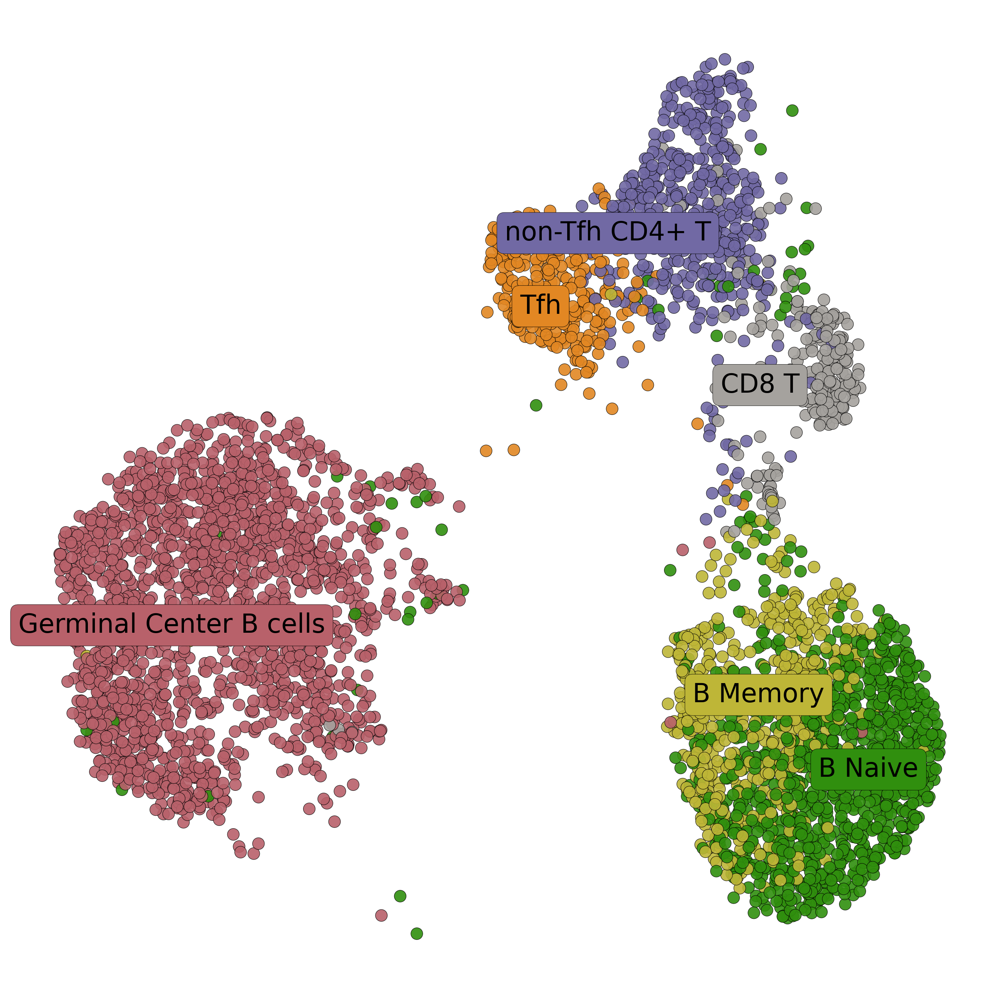

In [199]:
tonsil.init_cartography(adata[adata.obs.cell_type_paper.isin([
    'Germinal Center B cells', 
    # 'Plasma cells', 
    'B_naive', 'B_memory', 'T_CD8', 
    'T_follicular_helper', 'Naive CD4 T', 'non-Tfh CD4+ T'])])

tonsil.chart.plot_umap(
    hue='cell_type_paper',
    color_dict=color_dict,
    scatter_size=30,
    linewidth=0.2,
    legend_fontsize=12,
    figsize=(8, 8),
    rename={
        'T_follicular_helper': 'Tfh',
        'T_CD8': 'CD8 T',
        'T_CD4': 'non-Tfh CD4 T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
    },
    dpi=200
)

plt.savefig('./figures/umap.svg', **figure_params)
plt.show()

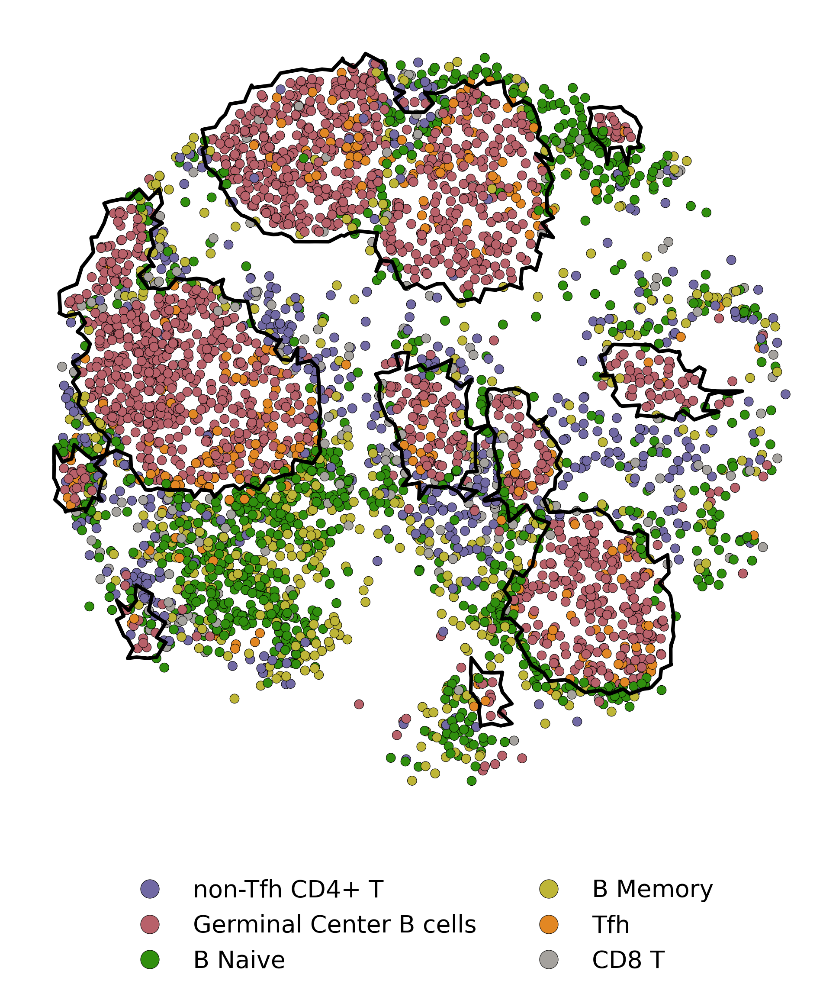

In [198]:
plt.rcParams['figure.figsize'] = (6, 6)
plt.rcParams['figure.dpi'] = 200


import alphashape

ct_points_wt = {}
for ct in adata.obs['cell_type_paper'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_paper'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

adatax = adata[adata.obs.cell_type_paper.isin([
    'Germinal Center B cells', 
    # 'Plasma cells', 
    'B_naive', 'B_memory', 'T_CD8', 
    'T_follicular_helper', 'Naive CD4 T', 'non-Tfh CD4+ T'])]

sns.scatterplot(data=adatax.obs, 
    x=adatax.obsm['spatial'][:,0], 
    y=adatax.obsm['spatial'][:,1],
    s=15,
    linewidth=0.2,
    edgecolor='black',
    hue='cell_type_paper',
    legend='brief', palette=color_dict)
plt.axis('off')

alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
for geom in alpha_shape.geoms:
    if geom.area > 10000:
        plt.plot(
            geom.exterior.xy[0], 
            geom.exterior.xy[1], 
            color='black', alpha=1)

plt.legend(bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)

handles, labels = plt.gca().get_legend_handles_labels()
new_labels = [rename[l].replace('\n', ' ') if l in rename else l for l in labels]
plt.gca().legend(handles, new_labels, bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)


plt.savefig('./figures/tonsil_celltypes.svg', **figure_params)
plt.show()

In [23]:
# fig, ax = plt.subplots(figsize=(6, 7), dpi=200)

adata_ = adata[adata.obs['banksy_celltypes'].isin(
    ['GC Intermediate Zone','GC Dark Zone','GC Light Zone']
)]
adata_.obs['x'] = np.array(adata_.obsm['spatial'][:, 0]).copy()
adata_.obs['y'] = np.array(adata_.obsm['spatial'][:, 1]).copy()
chart = Cartography(adata_, color_dict)

ct_points_wt = {}
for ct in chart.adata.obs['cell_type_major'].unique():
    points = np.asarray(
        chart.adata.obsm['spatial'][chart.adata.obs['cell_type_major'] == ct])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points
    
    
ct_points_split = {}
for ct in chart.adata.obs['cell_type_2'].unique():
    points = np.asarray(
        chart.adata.obsm['spatial'][chart.adata.obs['cell_type_2'] == ct])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_split[ct] = points
    

alpha_shapes = {}
alpha_shapes_split = {}


for cluster, points in ct_points_wt.items():
    alpha_shapes[cluster] = alphashape.alphashape(points, alpha=0.05)
    
for cluster, points in ct_points_split.items():
    alpha_shapes_split[cluster] = alphashape.alphashape(points, alpha=0.05)



adatax = adata[adata.obs.cell_type_paper.isin([
    'Germinal Center B cells', 
    'B_naive', 'B_memory', 'T_CD8', 
    'T_follicular_helper', 'Naive CD4 T', 'non-Tfh CD4+ T'])]


alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
# for geom in alpha_shape.geoms:
#     if geom.area > 10000:
#         plt.plot(
#             geom.exterior.xy[0], 
#             geom.exterior.xy[1], 
#             color='black', alpha=1)
        
# sns.scatterplot(data=adatax.obs, 
#     x=adatax.obsm['spatial'][:,0], 
#     y=adatax.obsm['spatial'][:,1],
#     s=25,
#     linewidth=0.2,
#     edgecolor='black',
#     hue='cell_type_paper',
#     legend='brief', palette=color_dict,
#     ax=ax)

# handles, labels = ax.get_legend_handles_labels()
# ax.legend(handles, labels)

# ax.set_frame_on(False)
# ax.set_xticks([])
# ax.set_yticks([])
# ax.set_xlabel('')
# ax.set_ylabel('')
# ax.set_aspect('equal')
# # ax.set_xlim(adata_.obs.x.min() - 10, adata_.obs.x.max() + 10)
# # ax.set_ylim(adata_.obs.y.min() - 10, adata_.obs.y.max() + 10)

# plt.legend(bbox_to_anchor=(0.5, -0.05), 
#     loc='upper center', ncol=2, frameon=False, 
#     markerscale=2, fontsize=10)

# handles, labels = plt.gca().get_legend_handles_labels()
# new_labels = [rename[l].replace('\n', ' ') if l in rename else l for l in labels]
# plt.gca().legend(handles, new_labels, bbox_to_anchor=(0.5, -0.05), 
#     loc='upper center', ncol=2, frameon=False, 
#     markerscale=2, fontsize=10)



# zone_alpha = 1
# area_thresh = 0


# for cluster in ['GC Light Zone', 'GC Intermediate Zone', 'GC Dark Zone']:
#     alpha_shape = alpha_shapes_split.get(cluster)
    
#     if alpha_shape is None:
#         continue

#     if isinstance(alpha_shape, MultiPolygon):
#         for geom in alpha_shape.geoms:
#             if geom.area > 50000:
#                 ax.fill(
#                     geom.exterior.xy[0], 
#                     geom.exterior.xy[1], 
#                     color=color_dict[str(cluster)], alpha=zone_alpha)
                
#     else:
#         geom = alpha_shape
#         ax.fill(
#             geom.exterior.xy[0], 
#             geom.exterior.xy[1], 
#             color=color_dict[str(cluster)], 
#             alpha=zone_alpha
#         )


# plt.tight_layout()

# plt.show()

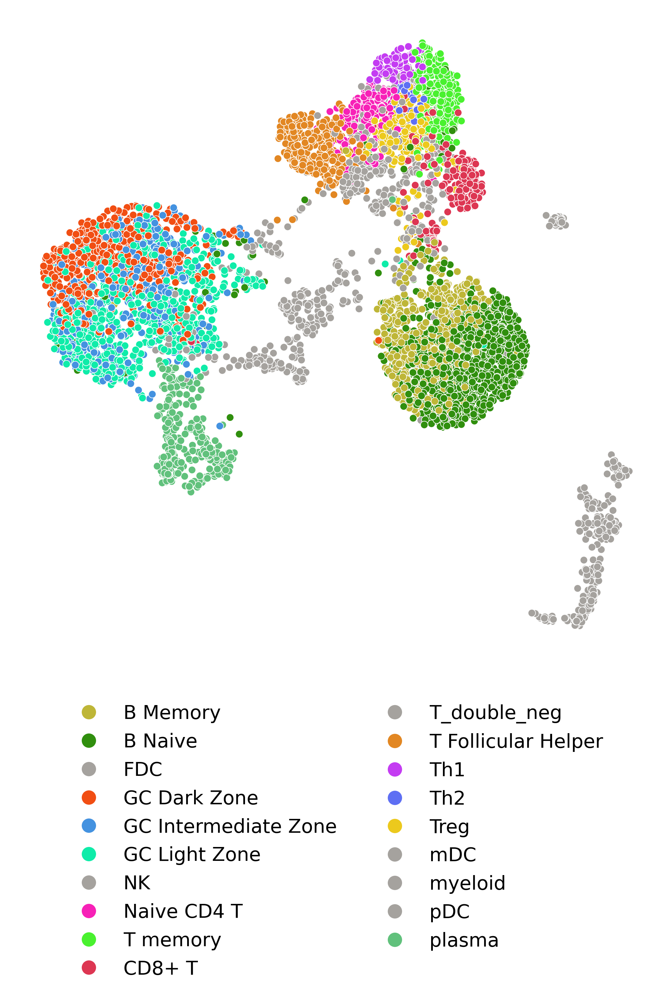

In [294]:
plt.rcParams['figure.figsize'] = (6, 6)

import alphashape

ct_points_wt = {}
for ct in adata.obs['cell_type_paper'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_paper'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

adatax = adata

sns.scatterplot(data=adatax.obs, 
    x=adatax.obsm['X_umap'][:,0], 
    y=adatax.obsm['X_umap'][:,1],
    s=15,
    hue='cell_type_2',
    legend='brief', 
    palette=color_dict
    )
plt.axis('off')

# alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
# for geom in alpha_shape.geoms:
#     if geom.area > 10000:
#         plt.plot(
#             geom.exterior.xy[0], 
#             geom.exterior.xy[1], 
#             color='black', alpha=1)

plt.legend(bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)

handles, labels = plt.gca().get_legend_handles_labels()
new_labels = [rename[l].replace('\n', ' ') if l in rename else l for l in labels]
plt.gca().legend(handles, new_labels, bbox_to_anchor=(0.5, -0.05), 
    loc='upper center', ncol=2, frameon=False, 
    markerscale=2, fontsize=10)


# plt.savefig('./figures/tonsil_celltypes.svg', **figure_params)
plt.show()

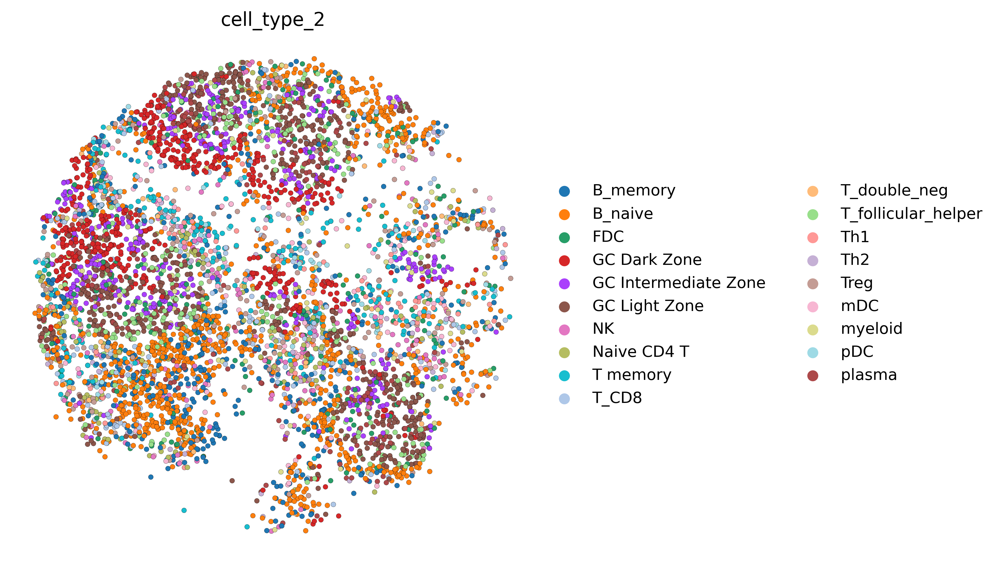

In [289]:
sc.pl.embedding(adata, show=False, basis='spatial',frameon=False, color='cell_type_2', linewidth=0.1, edgecolor='black', s=40)
plt.show()

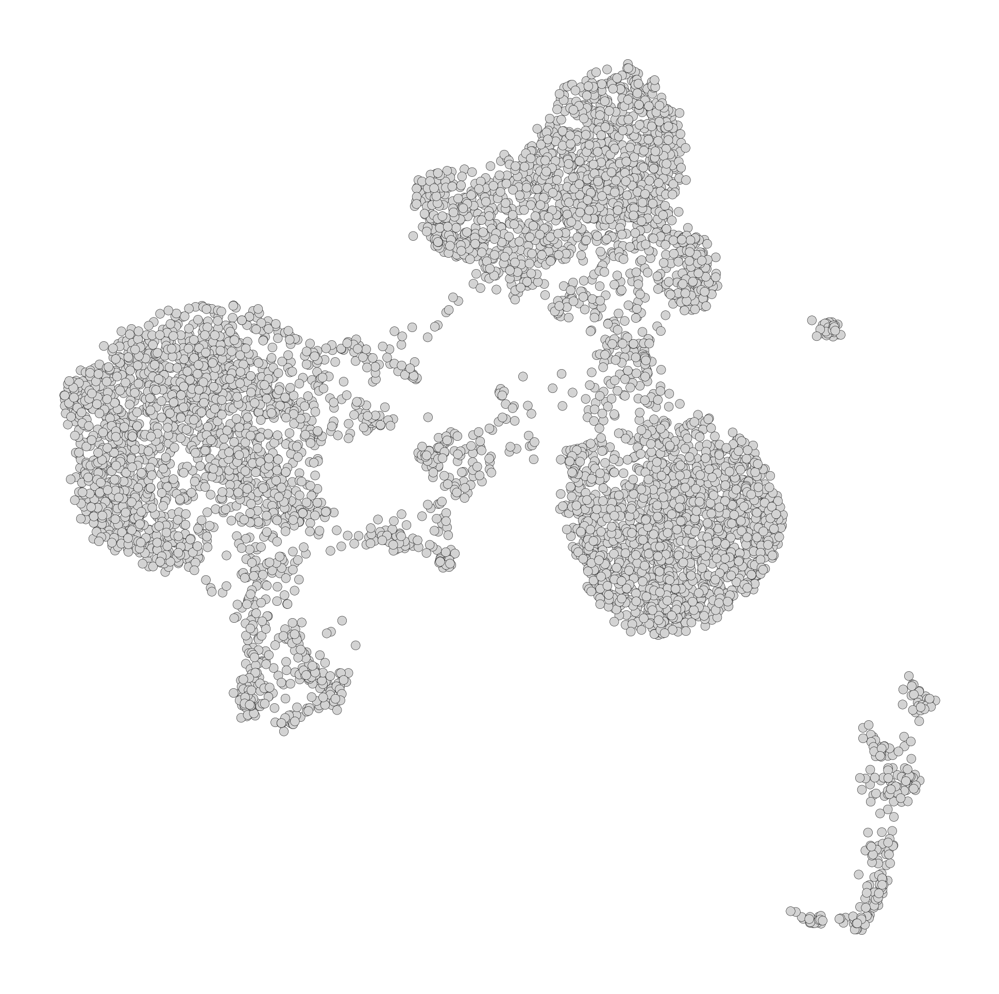

In [284]:
sc.pl.umap(adata, show=False, frameon=False, cmap='Blues', linewidth=0.1, edgecolor='black', s=40)
plt.show()

In [ ]:
atmp = adata[~adata.obs.index.isin(adata.obs.iloc[[2250, 2593, 3255, 5281]].index)]
# atmp = adata[pd.read_csv('GC_selection.csv', index_col=0).index]
# atmp = adata
tonsil.init_cartography(atmp, 
    restrict_to=[
        'Naive CD4 T',
        'T_follicular_helper', 
        'Th2', 
        'Th1', 
        'Treg',
        'T_CD8',
    ]
)

plot_params = {
    'perturb_target': '',
    'mode': '0',
    'hue': 'cell_type_2',
    'curve': True,
    'grid_scale': 2, 
    'grains': 25,
    'figsize': (4, 4),
    'dpi': 200,
    'legend_fontsize': 5,
    'rename': {
        'T_follicular_helper': 'Tfh',
        'T_CD8': 'CD8 T',
        'T_CD4': 'non-Tfh CD4 T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
    },
    'limit_clusters': True,
    'highlight_clusters': [
        'T_follicular_helper',
        'Th1', 
        'Th2',
        'Naive CD4 T',
        'Treg'
    ]
}

In [53]:
from sklearn.neighbors import KNeighborsRegressor

def _knn_regression(x, y, x_new, y_new, value, n_knn=30):

    data = np.stack([x, y], axis=1)

    model = KNeighborsRegressor(n_neighbors=n_knn)
    model.fit(data, value)

    data_new = np.stack([x_new, y_new], axis=1)

    return model.predict(data_new)

In [54]:
atmp = adata.copy()
atmp = atmp[atmp.obs['cell_type_2'].isin(['T_follicular_helper', 'Naive CD4 T'])]

... storing 'cell_type_2' as categorical
... storing 'cell_type_major' as categorical


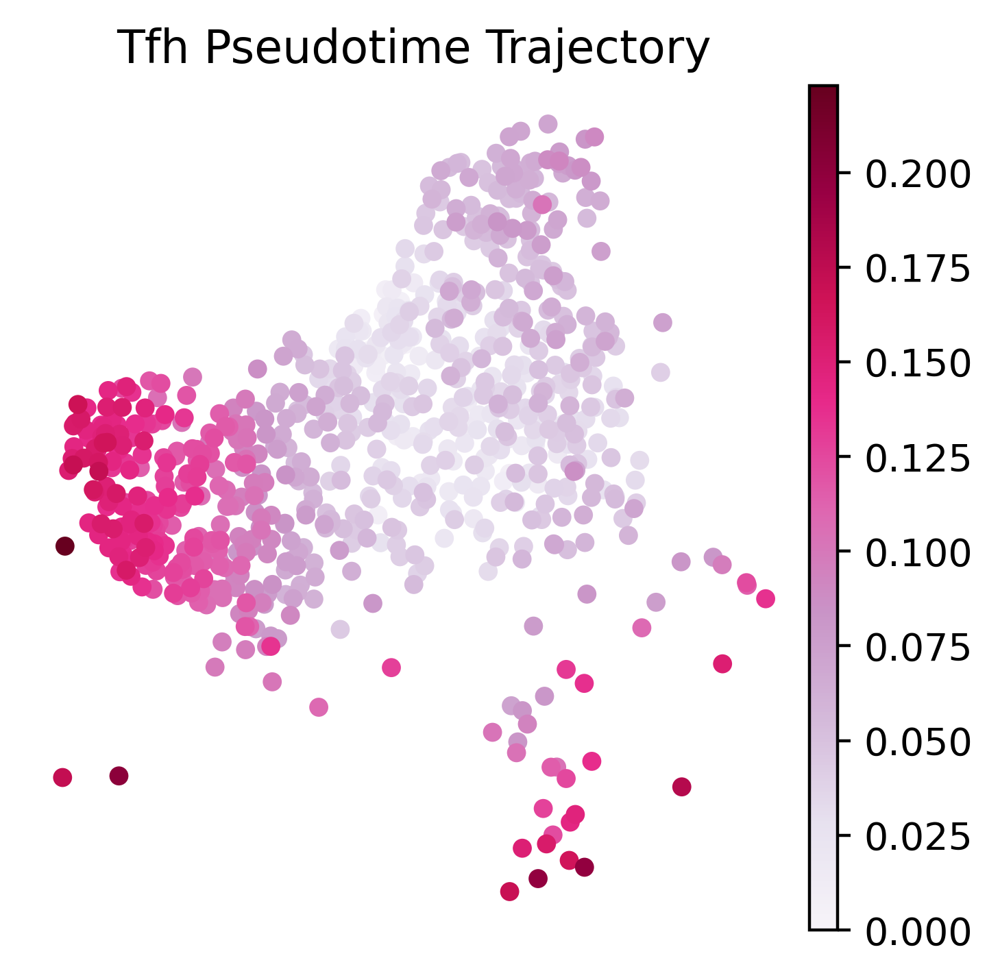

In [43]:
adata.uns['iroot'] = np.flatnonzero(adata.obs['cell_type_2'] == 'Naive CD4 T')[0]
# atmp.uns['iroot'] = np.flatnonzero(atmp.obs['cell_type_2'] == 'Naive CD4 T')[0]

mask = adata.obs['cell_type_2'].isin(['T_follicular_helper', 'Naive CD4 T', 'Treg', 'Th1', 'Th2', 'T CD8+'])

sc.tl.diffmap(adata)
sc.tl.dpt(adata, n_dcs=15, n_branchings=0)
plot = sc.pl.umap(adata[mask], 
           color=['dpt_pseudotime'], size=100, frameon=False, show=False,
           cmap='PuRd', colorbar_loc='right')
plt.title('Tfh Pseudotime Trajectory') 
# plt.savefig(
#     './figures/Tfh_pseudotime.svg',
#     **figure_params
# )
plt.show()

In [48]:
tfh_alignment_scores = {
    'IL21_OVX': 0.987342156,
    'IL21_KO': -0.887431209,
    'PRDM1_OVX': 0.053178934,
    'PRDM1_KO': 0.934267891,
    'IL21_KO_PRDM1_KO': 0.911423478,
    'IL21_OVX_PRDM1_KO': 0.977212345,
    'IL21_KO_PRDM1_OVX': 0.09123567,
    'IL21_OVX_PRDM1_OVX': 0.022456789,
}

In [91]:
# perturbed_df = pd.read_parquet(
#     '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet')

# grid_points, vector_field = tonsil.plot_arrows(
#     perturbed_df=perturbed_df,
#     n_neighbors=200,
#     alpha=0.6,
#     scale=6,
#     threshold=1,
#     dynamic_alpha=False,
#     scatter_size=25,
#     **plot_params
# )

# text = f'Tfh-differentiation\nalignment = {tfh_alignment_scores["IL21_OVX"]:.3f}'
# plt.annotate(text, xy=(0.25, 0.85), xycoords='axes fraction',
#             bbox=dict(facecolor='ivory', edgecolor='black', alpha=0.4,
#                      boxstyle='round,pad=0.5', linewidth=0.5),
#             ha='center', va='center', fontsize=6)

# plt.title('Simulated IL21 Overexpression')
# xlim = plt.xlim()
# ylim = plt.ylim()
# plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
# plt.ylim(ylim[0]*0.95, ylim[1]*1.05)

# plt.show()

In [20]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/FOXO1_4n_0x.parquet')

In [173]:
# # atmp = adata[~adata.obs.index.isin(adata.obs.iloc[[2250, 2593, 3255, 5281]].index)]
# atmp = adata[pd.read_csv(
#     '/Users/koush/Projects/SpaceOracle/notebooks/human_tonsil/GC_selection.csv', index_col=0).index]
# # atmp = adata
# tonsil.init_cartography(atmp, 
#     restrict_to=[
#         'GC Intermediate Zone',
#         'GC Light Zone', 
#         'GC Dark Zone', 
#     ]
# )
# plot_params['highlight_clusters'] = [
#         'GC Intermediate Zone',
#         'GC Light Zone', 
#         'GC Dark Zone', 
#     ]
# grid_points, vector_field = tonsil.plot_arrows(
#     perturbed_df=perturbed_df,
#     n_neighbors=200,
#     **plot_params
# )
# plt.title('Simulated FOXO1 KO')
# plt.show()

In [21]:
from spaceoracle.plotting.shift import estimate_transition_probabilities
import alphashape

delta_X = perturbed_df.values - adata.layers['imputed_count']
layout_embedding = adata.obsm['spatial']
n_neighbors = 40
remove_null = True
normalize = True
            
P = estimate_transition_probabilities(
    adata, delta_X, layout_embedding, n_neighbors=n_neighbors, n_jobs=1)

if remove_null:
    P_null = estimate_transition_probabilities(
        adata, delta_X * 0, layout_embedding, n_neighbors=n_neighbors, n_jobs=1)
    P = P - P_null
    
if normalize:
    P = (P - P.min()) / (P.max() - P.min())
    P = P / P.sum(axis=1)[:, np.newaxis]

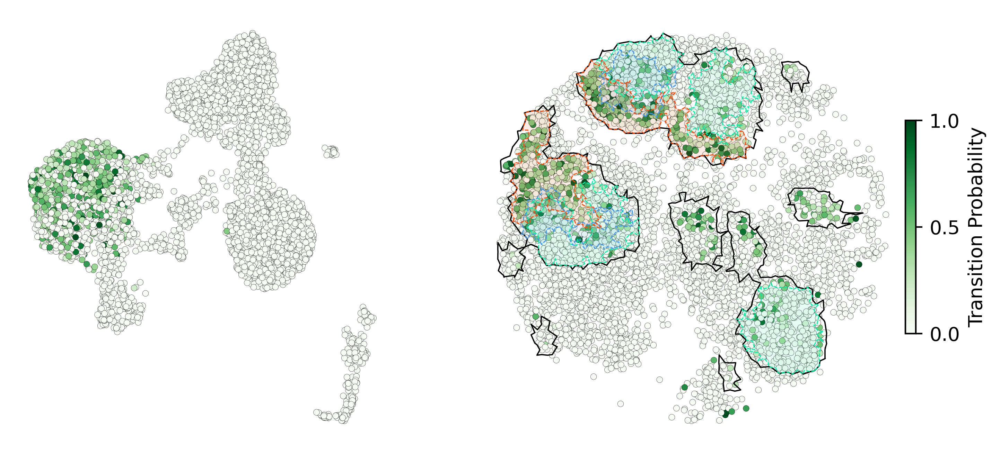

In [42]:
from_ct = adata.obs['cell_type_2'].isin(['GC Dark Zone', 'GC Intermediate Zone'])
to_ct = adata.obs['cell_type_2'].isin(['GC Light Zone', 'GC Intermediate Zone'])

probs = np.zeros(adata.n_obs)
probs[from_ct] = P[from_ct][:, to_ct].max(axis=1)

probs = (probs - probs.min()) / (probs.max() - probs.min())

adata.obs['tfh_transition_prob'] = probs
cmap = 'Greens'
s = 10
alpha = 1
edgecolor = 'black'
linewidth = 0.1
fig, ax = plt.subplots(1, 2, figsize=(9, 4), dpi=200, width_ratios=[0.75, 1])
scatter = ax[1].scatter(
    adata.obsm['spatial'][:,0],
    adata.obsm['spatial'][:,1],
    c=adata.obs['tfh_transition_prob'],
    cmap=cmap,
    linewidth=linewidth,
    edgecolor=edgecolor,
    alpha=alpha,
    # sizes=adata.obs['tfh_transition_prob']*35,
    s=s
)

scatter = ax[0].scatter(
    adata.obsm['X_umap'][:,0],
    adata.obsm['X_umap'][:,1],
    c=adata.obs['tfh_transition_prob'],
    cmap=cmap,
    linewidth=linewidth,
    edgecolor=edgecolor,
    alpha=alpha,
    s=s
)

plt.colorbar(scatter, shrink=0.5, 
    orientation='vertical', ax=ax[1], pad=0, ticks=[0, 0.5, 1], 
    # boundaries=np.linspace(0, 1, 100), 
    label='Transition Probability'
)

ct_points_wt = {}
for ct in adata.obs['cell_type_paper'].unique():
    points = np.asarray(
        adata[adata.obs['cell_type_paper'] == ct].obsm['spatial'])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points

alpha_shape = alphashape.alphashape(ct_points_wt['Germinal Center B cells'], alpha=0.035)
for geom in alpha_shape.geoms:
    if geom.area > 10000:
        ax[1].plot(
            geom.exterior.xy[0],
            geom.exterior.xy[1],
            color='black',
            alpha=1,
            linewidth=0.65
        )
        
ax[0].set_frame_on(False)
ax[1].set_frame_on(False)
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[1].set_xticks([])
ax[1].set_yticks([])

zone_alpha = 0.1

for cluster in ['GC Light Zone', 'GC Intermediate Zone', 'GC Dark Zone']:
    alpha_shape = alpha_shapes_split.get(cluster)
    
    if alpha_shape is None:
        continue

    if isinstance(alpha_shape, MultiPolygon):
        for geom in alpha_shape.geoms:
            if geom.area > 50000:
                ax[1].fill(
                    geom.exterior.xy[0], 
                    geom.exterior.xy[1], 
                    color=color_dict[str(cluster)], 
                    alpha=zone_alpha)
                
                ax[1].plot(
                    geom.exterior.xy[0],
                    geom.exterior.xy[1],
                    color=color_dict[str(cluster)],
                    alpha=1,
                    linestyle='--',
                    linewidth=0.5
                )
                
    else:
        geom = alpha_shape
        ax[1].fill(
            geom.exterior.xy[0], 
            geom.exterior.xy[1], 
            color=color_dict[str(cluster)], 
            alpha=zone_alpha
        )


# plt.suptitle('Transitions to Light Zone phenotype \nin Germinal Center\nafter FOXO1 KO')
plt.axis('off')
plt.savefig(
    './figures/transition_probs.svg', 
    **figure_params)
plt.show()

In [74]:
tonsil = VirtualTissue(
    adata = adata,
    annot = 'cell_type_2',
    betadatas_path = '/Volumes/SSD/lasso_runs/human_tonsil',
    ko_path = '/Volumes/SSD/genome_screens/human_tonsil',
    color_dict=color_dict
)

In [75]:
def add_alignment_annotation(condition):
    text = f'Tfh-differentiation\nalignment = {tfh_alignment_scores[condition]:.3f}'
    plt.annotate(text, xy=(0.25, 0.85), xycoords='axes fraction',
                bbox=dict(facecolor='ivory', edgecolor='black', alpha=0.4,
                         boxstyle='round,pad=0.5', linewidth=0.5),
                ha='center', va='center', fontsize=6)

In [95]:
with open('./colors.json', 'r') as f:
    color_dict = json.load(f)
    
atmp = adata[~adata.obs.index.isin(adata.obs.iloc[[2250, 2593, 3255, 5281]].index)]

tonsil.init_cartography(atmp, 
    restrict_to=[
        'Naive CD4 T',
        'T_follicular_helper', 
        'Th2', 
        'Th1', 
        'Treg',
        'T_CD8',
    ]
)

plot_params = {
    'perturb_target': '',
    'mode': '0',
    'hue': 'cell_type_2',
    'curve': True,
    'grid_scale': 2, 
    'alpha': 0.5,
    'grains': 25,
    'figsize': (4, 4),
    'dpi': 200,
    'legend_fontsize': 7,
    'dynamic_alpha': False,
    'scatter_size': 25,
    'rename': {
        'T_follicular_helper': 'Tfh',
        'T_CD8': 'CD8 T',
        'T_CD4': 'non-Tfh CD4 T',
        'B_germinal_center': 'B Germinal Center',
        'B_naive': 'B Naive',
        'B_memory': 'B Memory',
        'Naive CD4 T': 'Th0',
    },
    'limit_clusters': True,
    'highlight_clusters': [
        'T_follicular_helper',
        'Th1', 
        'Th2',
        'Naive CD4 T',
        'Treg',
    ]
}

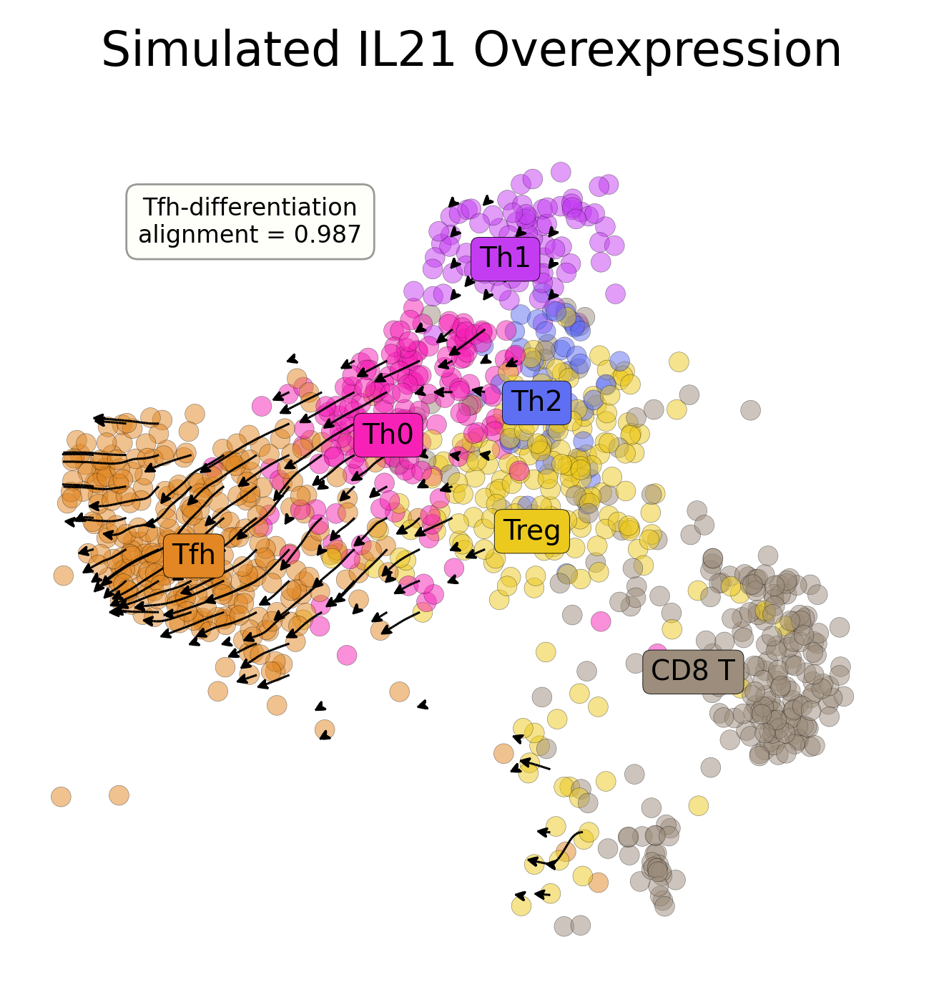

In [96]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=200,
    scale=7,
    threshold=1,
    **plot_params
)

add_alignment_annotation('IL21_OVX')
plt.title('Simulated IL21 Overexpression')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/IL21_OVX.svg', 
    **figure_params
)
plt.show()

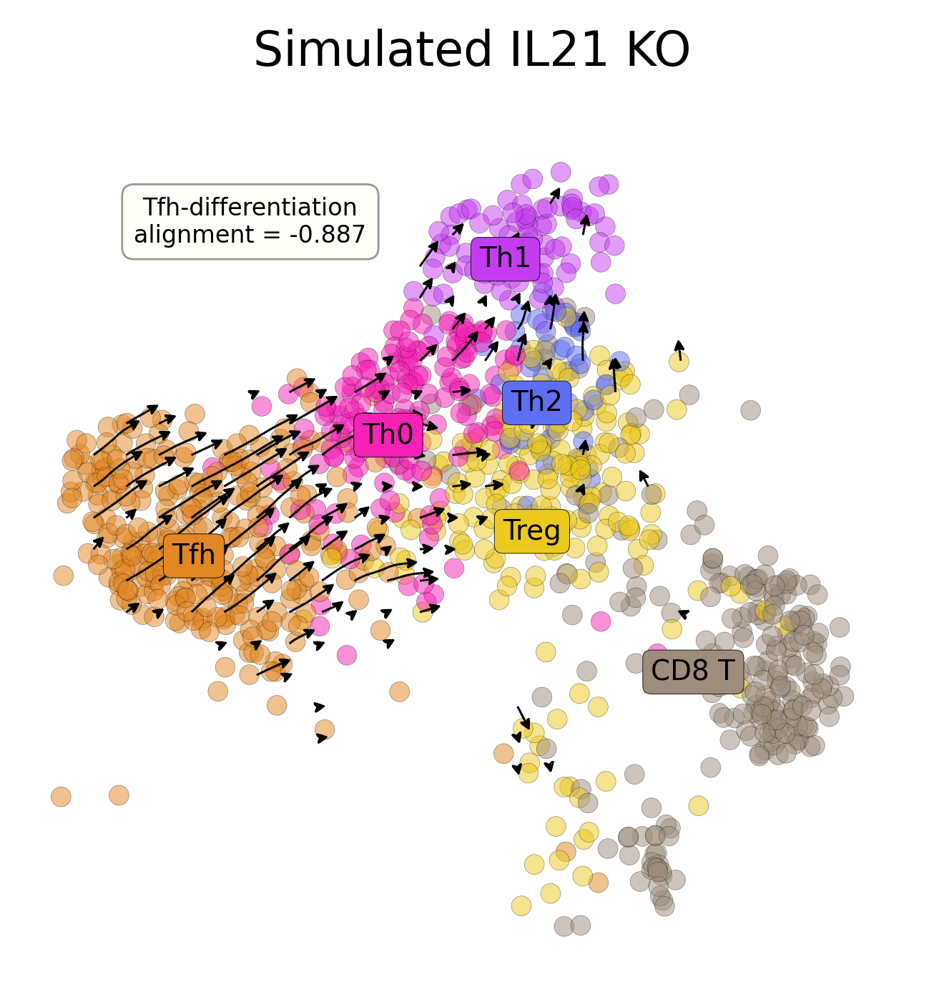

In [97]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=200,
    scale=8,
    threshold=0.1,
    **plot_params
)

add_alignment_annotation('IL21_KO')
plt.title('Simulated IL21 KO')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/IL21_KO.svg', 
    **figure_params
)
plt.show()

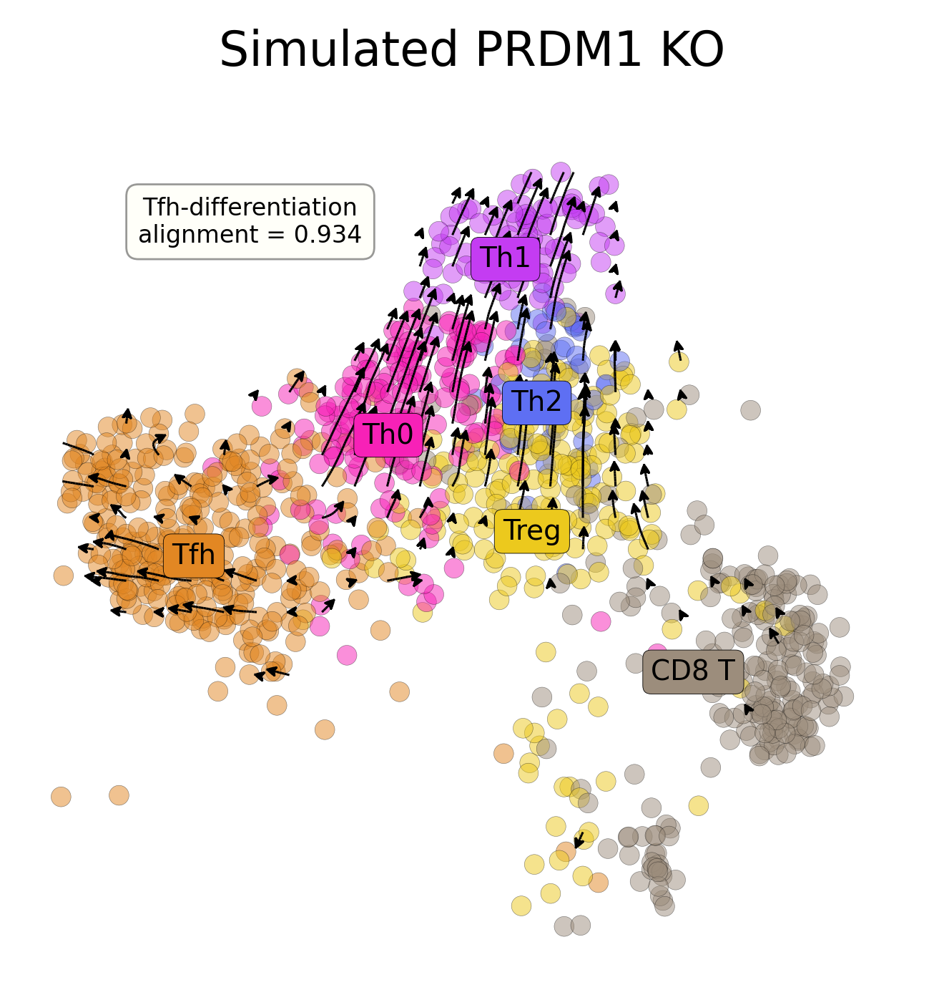

In [114]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=450,
    scale=10,
    threshold=0.1,
    **plot_params
)

add_alignment_annotation('PRDM1_KO')
plt.title('Simulated PRDM1 KO')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/PRDM1_KO.svg', 
    **figure_params
)
plt.show()

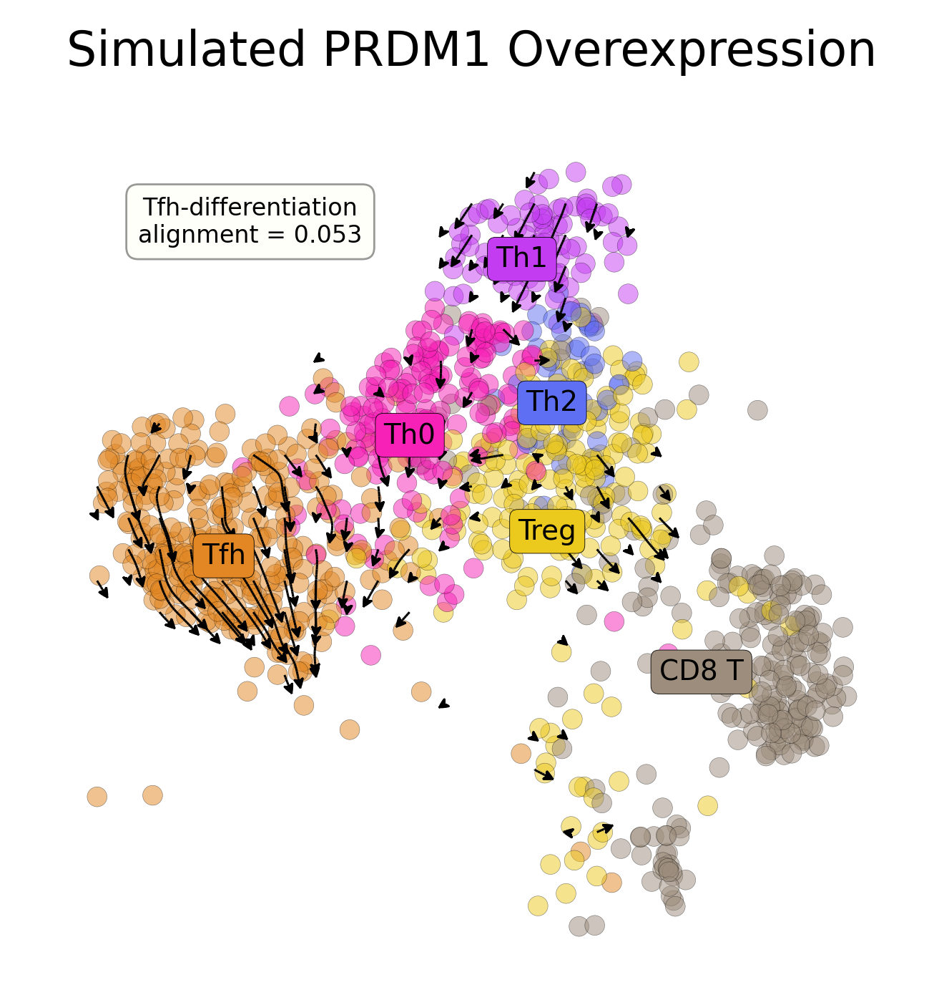

In [117]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=150,
    scale=6,
    threshold=0.2,
    **plot_params
)

add_alignment_annotation('PRDM1_OVX')
plt.title('Simulated PRDM1 Overexpression')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/PRDM1_OVX.svg', 
    **figure_params
)
plt.show()

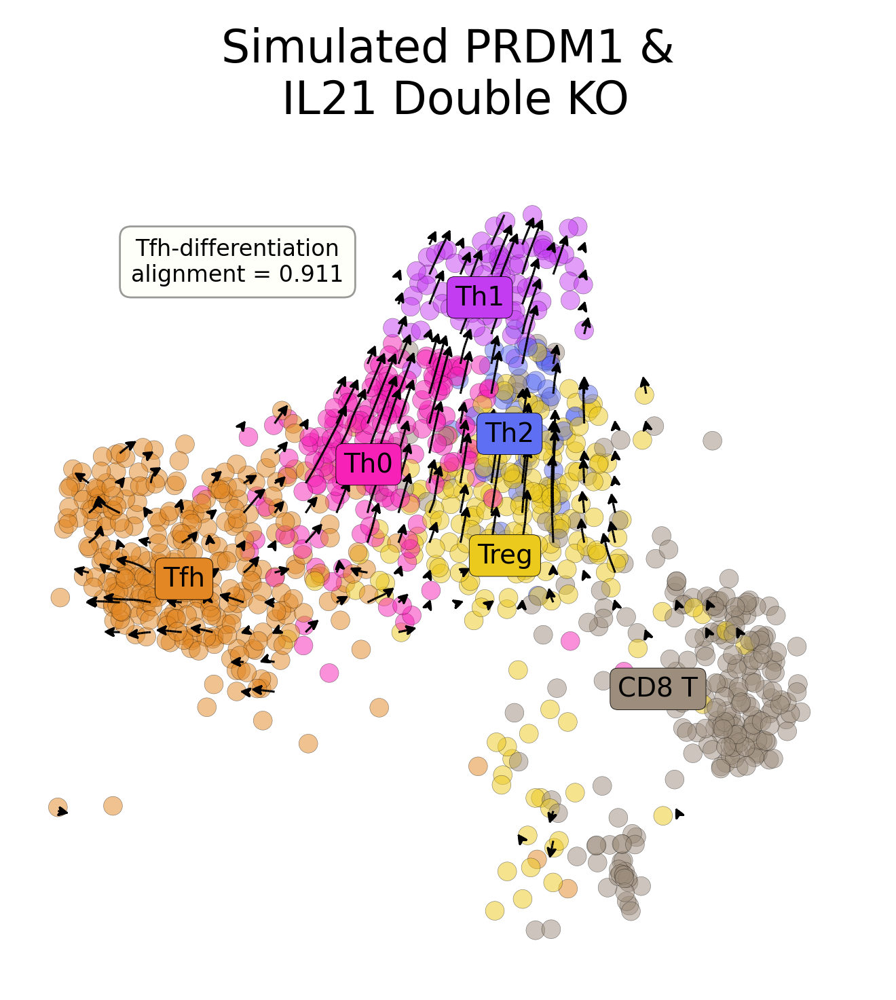

In [122]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_0x_IL21_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=500,
    scale=8,
    threshold=0.05,
    **plot_params
)

add_alignment_annotation('IL21_KO_PRDM1_KO')
plt.title('Simulated PRDM1 &\n IL21 Double KO')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/PRDM1_KO_IL21_KO.svg', 
    **figure_params
)
plt.show()

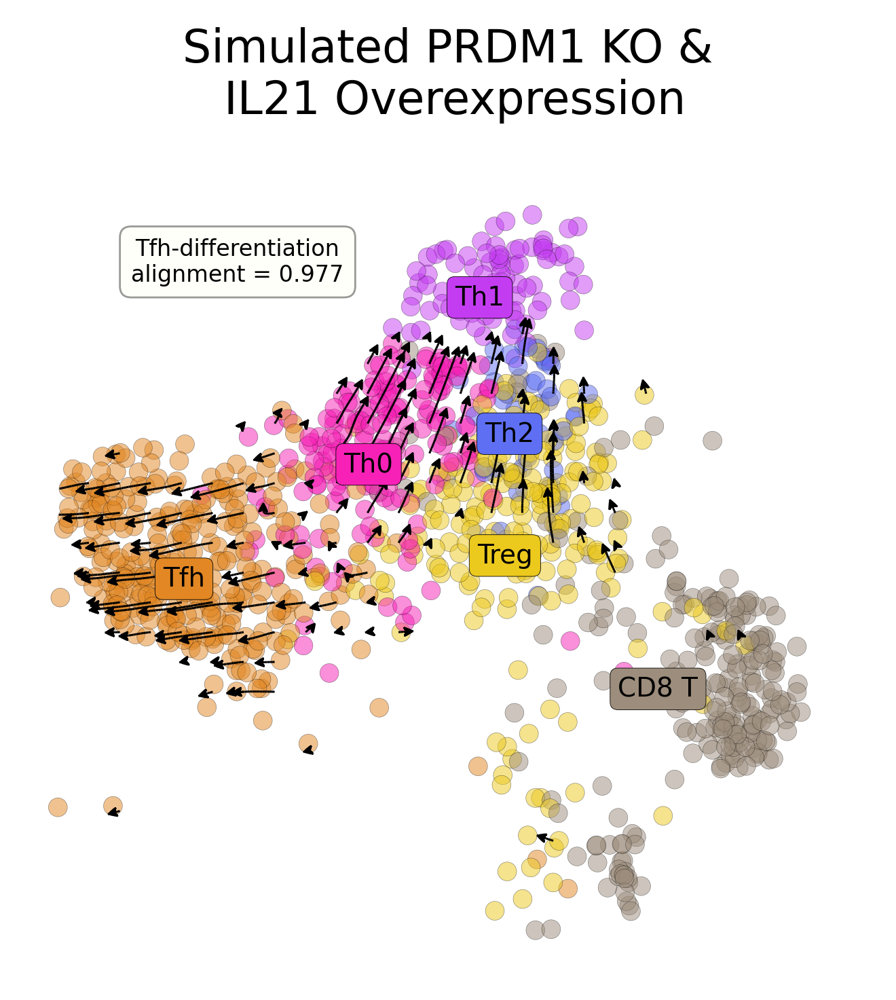

In [124]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_0x_IL21_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=600,
    scale=8,
    threshold=0.1,
    **plot_params
)

add_alignment_annotation('IL21_OVX_PRDM1_KO')
plt.title('Simulated PRDM1 KO &\n IL21 Overexpression')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/PRDM1_KO_IL21_OVX.svg', 
    **figure_params
)
plt.show()

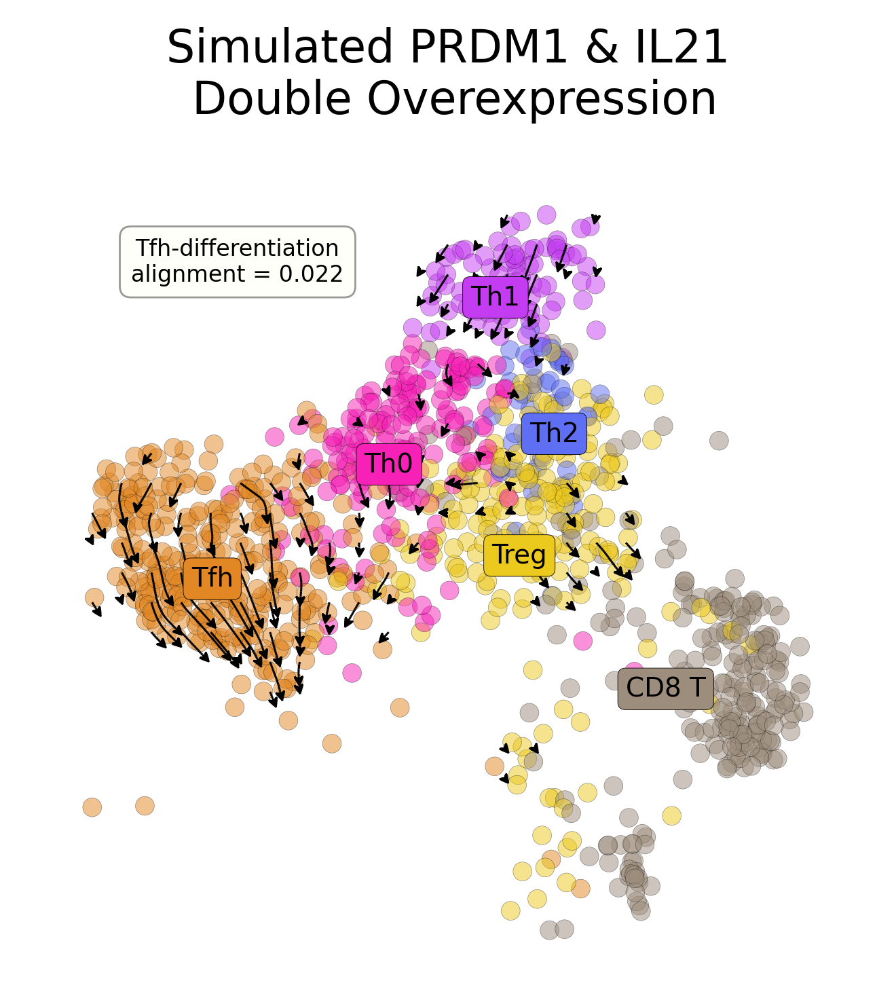

In [129]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_maxx_IL21_maxx.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=150,
    scale=4.5,
    threshold=0.2,
    **plot_params
)
add_alignment_annotation('IL21_OVX_PRDM1_OVX')
plt.title('Simulated PRDM1 & IL21\n Double Overexpression')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.savefig(
    './figures/PRDM1_OVX_IL21_OVX.svg', 
    **figure_params
)
plt.show()

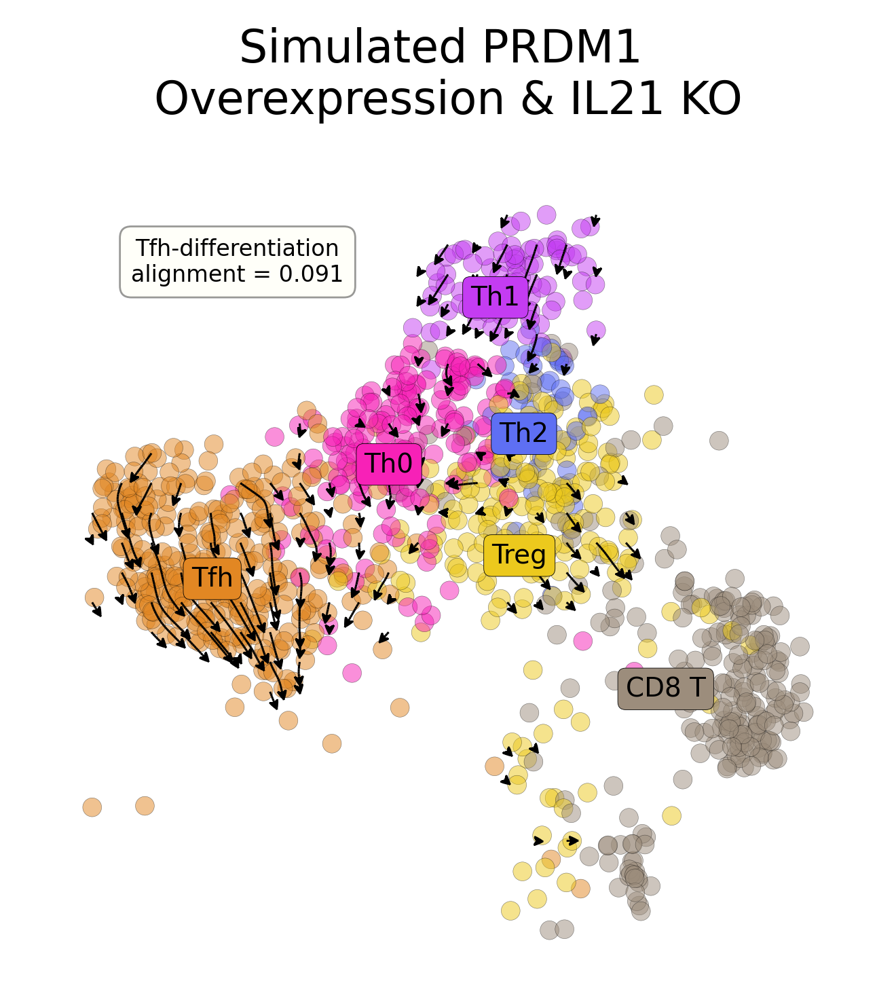

In [131]:
perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/PRDM1_4n_maxx_IL21_0x.parquet')

grid_points, vector_field = tonsil.plot_arrows(
    perturbed_df=perturbed_df,
    n_neighbors=150,
    scale=5,
    threshold=0.15,
    **plot_params
)
add_alignment_annotation('IL21_KO_PRDM1_OVX')
xlim = plt.xlim()
ylim = plt.ylim()
plt.xlim(xlim[0]*0.95, xlim[1]*1.05)
plt.ylim(ylim[0]*0.95, ylim[1]*1.05)
plt.title('Simulated PRDM1 \nOverexpression & IL21 KO')
plt.savefig(
    './figures/PRDM1_OVX_IL21_KO.svg', 
    **figure_params
)
plt.show()

In [183]:
from spaceoracle.models.parallel_estimators import create_spatial_features
from scipy.stats import pearsonr
from spaceoracle.plotting.cartography import xy_from_adata

In [184]:
def plot_gene_vs_proximity(perturb_target, perturbed_df, gene, color_gene, cell_filter, 
                          proximity_threshold=150, gene_threshold=0.005, ax=None, mode='ko'):
    # perturbed_df = pd.read_parquet(
    #     f'/Volumes/SSD/genome_screens/human_tonsil/{perturb_target}_4n_maxx.parquet')
    
    datadf = spf[
        [i+'_within' for i in cell_groups['GC B Cells']
            ]].sum(1).to_frame().join(adata.obs.cell_type_2).query(
             f'cell_type_2.isin(["{cell_filter}"])').join(xy).join(
        ((perturbed_df-adata.to_df(layer='imputed_count'))/adata.to_df(layer='imputed_count'))*100
    )
    datadf = datadf[datadf[0] < proximity_threshold]
    
    if ax is None:
        ax = plt.gca()
    
    try:
        corr = pearsonr(datadf[datadf[gene]>gene_threshold][0], datadf[datadf[gene]>gene_threshold][gene]).statistic
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: {corr:.4f}")
    except:
        corr = 0
        ax.set_title(f"{perturb_target} {mode} in\n{cell_filter}\nCorrelation: NaN")
        
    scatter = ax.scatter(
        datadf[0], 
        datadf[gene], 
        c=datadf[color_gene],
        cmap='rainbow',
    )
    cbar = plt.colorbar(scatter, label=f'{color_gene} % change', shrink=0.5, ax=ax, format='%.2f')
    cbar.ax.tick_params(labelsize=10)
    cbar.set_label(f'{color_gene} % change', fontsize=12)
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.set_ylabel(f'{gene} % change', fontsize=14)    
    ax.set_xlabel(f'Number of GC B cells within {RADIUS}um', fontsize=14)
    
    return ax, datadf

In [185]:
adata = sc.read_h5ad('/Volumes/SSD/training_data/snrna_human_tonsil.h5ad')
adata.obsm['X_umap'] = pd.read_csv('../../notebooks/human_tonsil/umap.csv', index_col=0).values
adata.obs = adata.obs.join(pd.read_csv('../../notebooks/human_tonsil/tonsil_cell_types.csv', index_col=0))

adata.layers['imputed_count'] = np.load('../../notebooks/human_tonsil/imputed_counts.npy')

RADIUS = 200

xy = xy_from_adata(adata)

spf = create_spatial_features(
    x=adata.obsm['spatial'][:, 0], 
    y=adata.obsm['spatial'][:, 1], 
    celltypes=adata.obs.cell_type_2, 
    obs_index=adata.obs_names,
    radius = RADIUS
)

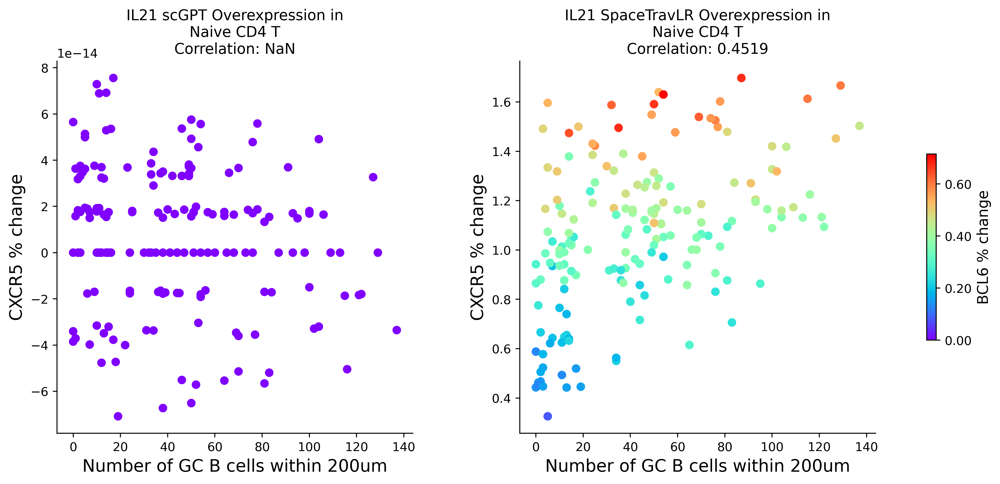

In [197]:
plt.rcParams['figure.figsize'] = (7, 6)
plt.rcParams['figure.dpi'] = 100

f, axs = plt.subplots(1, 2, figsize=(15, 5.5), dpi=200)
plt.subplots_adjust(wspace=0.3)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil_scGPT/IL21_4n_maxx.parquet'
)

ax1, df1 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='scGPT Overexpression',
    gene='CXCR5', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T', 
    ax=axs[0]
)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet'
)

ax2, df2 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='SpaceTravLR Overexpression',
    gene='CXCR5', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T', 
    ax=axs[1]
)
color_gene = 'BCL6'
vmin = min(df1[color_gene].min(), df2[color_gene].min())
vmax = max(df1[color_gene].max(), df2[color_gene].max())

for ax in axs:
    if ax.collections:
        for collection in ax.collections:
            if hasattr(collection, 'colorbar'):
                collection.colorbar.remove()

scatter = axs[1].scatter([], [], c=[], cmap='rainbow', vmin=vmin, vmax=vmax)
cbar = plt.colorbar(scatter, ax=axs, label=f'BCL6 % change', shrink=0.5, format='%.2f')
cbar.ax.tick_params(labelsize=10)
cbar.set_label(f'BCL6 % change', fontsize=12)

for ax in axs:
    ax.collections[0].set_clim(vmin, vmax)
plt.savefig(
    './figures/proximity_b.svg', 
    **figure_params
)
plt.show()

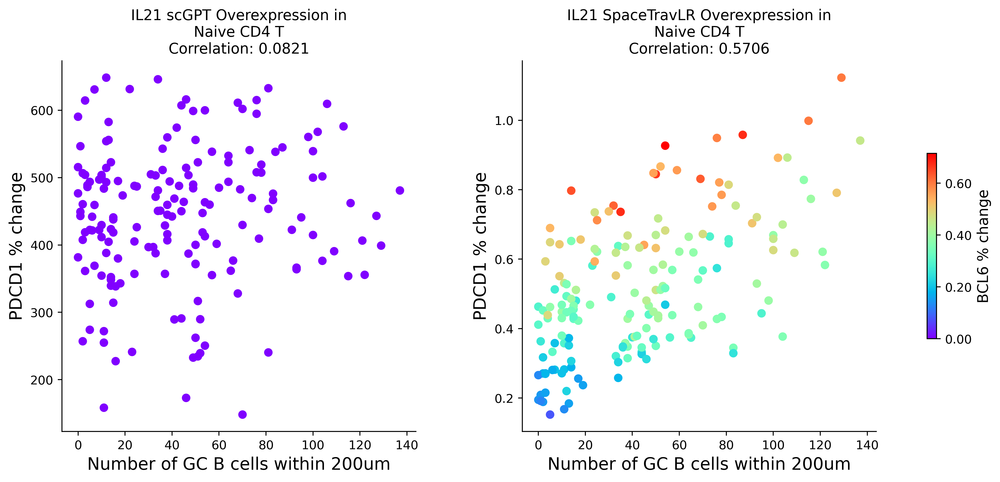

In [196]:
plt.rcParams['figure.figsize'] = (7, 6)
plt.rcParams['figure.dpi'] = 100

f, axs = plt.subplots(1, 2, figsize=(15, 5.5), dpi=200)
plt.subplots_adjust(wspace=0.3)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil_scGPT/IL21_4n_maxx.parquet')


ax1, df1 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='scGPT Overexpression',
    gene='PDCD1', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T', 
    ax=axs[0]
    
)

perturbed_df = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/IL21_4n_maxx.parquet')


ax2, df2 = plot_gene_vs_proximity(
    perturb_target='IL21',
    perturbed_df=perturbed_df, 
    mode='SpaceTravLR Overexpression',
    gene='PDCD1', 
    color_gene='BCL6', 
    cell_filter='Naive CD4 T',
    ax=axs[1]
)
color_gene = 'BCL6'
vmin = min(df1[color_gene].min(), df2[color_gene].min())
vmax = max(df1[color_gene].max(), df2[color_gene].max())

for ax in axs:
    if ax.collections:
        for collection in ax.collections:
            if hasattr(collection, 'colorbar'):
                collection.colorbar.remove()

scatter = axs[1].scatter([], [], c=[], cmap='rainbow', vmin=vmin, vmax=vmax)
cbar = plt.colorbar(scatter, ax=axs, label=f'BCL6 % change', shrink=0.5, format='%.2f')
cbar.ax.tick_params(labelsize=10)
cbar.set_label(f'BCL6 % change', fontsize=12)

for ax in axs:
    ax.collections[0].set_clim(vmin, vmax)
plt.savefig(
    './figures/proximity_a.svg', 
    **figure_params
)
plt.show()

In [76]:
impact_df = pd.read_csv('../../notebooks/human_tonsil/impact_df.csv', index_col=0)
out_ko_data_scgpt = pd.read_csv('../../notebooks/human_tonsil/out_ko_data_scgpt.csv', index_col=0)
out_ko_data_co = pd.read_csv('../../notebooks/human_tonsil/out_ko_data_CO.csv', index_col=0)

In [73]:
genes2 = ['FOXP3', 'GATA3', 'IL7', 'LGALS9', 'CD27', 'CXCR4']

In [37]:
# for i, gene in enumerate(genes2):
#     fig = tonsil.plot_comparative_radar(
#         gene=gene,
#         impact_dfs=[out_ko_data_scgpt, out_ko_data_co, impact_df],
#         labels=["scGPT", "CellOracle", "SpaceTravLR"],
#         show_for=show_for,
#         figsize=(8, 8),
#         label_size=16,
#         legend_size=14,
#         rename=rename,
#         dpi=300,
#         color_dict=color_dict,
#         show_legend=False
#     )
#     plt.savefig(f'./figures/comparative_radar_{gene}.svg', **figure_params)


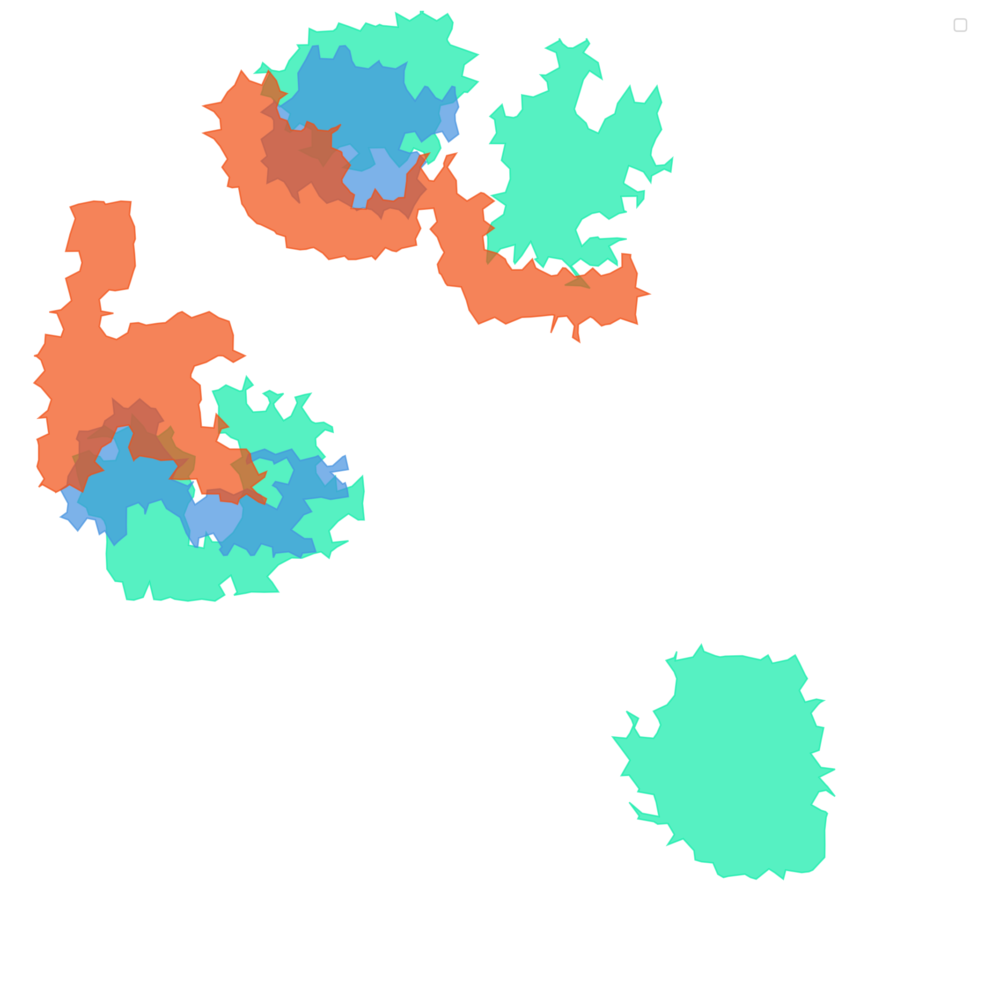

In [139]:
adata_ = adata[adata.obs['banksy_celltypes'].isin(
    ['GC Intermediate Zone','GC Dark Zone','GC Light Zone']
)]
adata_.obs['x'] = np.array(adata_.obsm['spatial'][:, 0]).copy()
adata_.obs['y'] = np.array(adata_.obsm['spatial'][:, 1]).copy()
chart = Cartography(adata_, color_dict)

ct_points_wt = {}
for ct in chart.adata.obs['cell_type_major'].unique():
    points = np.asarray(
        chart.adata.obsm['spatial'][chart.adata.obs['cell_type_major'] == ct])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_wt[ct] = points
    
    
ct_points_split = {}
for ct in chart.adata.obs['cell_type_2'].unique():
    points = np.asarray(
        chart.adata.obsm['spatial'][chart.adata.obs['cell_type_2'] == ct])
    delta = 30
    points = np.vstack(
        (points +[-delta,delta], points +[-delta,-delta], 
        points +[delta,delta], points +[delta,-delta]))
    ct_points_split[ct] = points
    

alpha_shapes = {}
alpha_shapes_split = {}


for cluster, points in ct_points_wt.items():
    alpha_shapes[cluster] = alphashape.alphashape(points, alpha=0.05)
    
for cluster, points in ct_points_split.items():
    alpha_shapes_split[cluster] = alphashape.alphashape(points, alpha=0.05)

fig, ax = plt.subplots(figsize=(20, 9), dpi=120)

zone_alpha = 0.7
area_thresh = 0

# for cluster in ['Germinal Center B cells']:
#     alpha_shape = alpha_shapes.get(cluster)
    
#     if alpha_shape is None:
#         continue

#     if isinstance(alpha_shape, MultiPolygon):
#         for geom in alpha_shape.geoms:
#             if geom.area > area_thresh:
#                 ax.fill(
#                     geom.exterior.xy[0], 
#                     geom.exterior.xy[1], 
#                     color=color_dict[str(cluster)], alpha=zone_alpha)
#     else:
#         geom = alpha_shape
#         ax.fill(
#             geom.exterior.xy[0], 
#             geom.exterior.xy[1], 
#             color=color_dict[str(cluster)], 
#             alpha=zone_alpha
#         )
        
#     for geom in alpha_shape.geoms:
#         if geom.area > 1000:
#             ax.plot(
#                 geom.exterior.xy[0], 
#                 geom.exterior.xy[1], 
#                 color='black', alpha=zone_alpha)


for cluster in ['GC Light Zone', 'GC Intermediate Zone', 'GC Dark Zone']:
    alpha_shape = alpha_shapes_split.get(cluster)
    
    if alpha_shape is None:
        continue

    if isinstance(alpha_shape, MultiPolygon):
        for geom in alpha_shape.geoms:
            if geom.area > 50000:
                ax.fill(
                    geom.exterior.xy[0], 
                    geom.exterior.xy[1], 
                    color=color_dict[str(cluster)], alpha=zone_alpha)
    else:
        geom = alpha_shape
        ax.fill(
            geom.exterior.xy[0], 
            geom.exterior.xy[1], 
            color=color_dict[str(cluster)], 
            alpha=zone_alpha
        )
        
# for ct in chart.adata.obs['banksy_celltypes'].unique():
#     ax.scatter(
#         chart.adata[chart.adata.obs['banksy_celltypes'] == ct].obsm['spatial'][:, 0],
#         chart.adata[chart.adata.obs['banksy_celltypes'] == ct].obsm['spatial'][:, 1],
#         c=color_dict[ct], alpha=1, edgecolor='black', linewidth=1,
#         label=ct
#     )



handles, labels = ax.get_legend_handles_labels()
ax.legend(handles, labels)

ax.set_frame_on(False)
ax.set_xticks([])
ax.set_yticks([])
ax.set_xlabel('')
ax.set_ylabel('')
ax.set_aspect('equal')
ax.set_xlim(adata_.obs.x.min() - 10, adata_.obs.x.max() + 10)
ax.set_ylim(adata_.obs.y.min() - 10, adata_.obs.y.max() + 10)
plt.tight_layout()
# plt.savefig(
#     '/tmp/GC_Zones.svg', 
#     **figure_params
# )

plt.show()

In [23]:
ko = pd.read_parquet(
    '/Volumes/SSD/genome_screens/human_tonsil/FOXO1_4n_0x.parquet')

In [17]:
coko = pd.read_csv('/tmp/celloracle_FOXO1_KO.csv', index_col=0)

In [ ]:
geens = ['CXCL8', 'CXCL2', 'CXCR4']

In [29]:
(coko - adata.to_df(layer='imputed_count'))['CXCR4'].mean() /\
    adata.to_df(layer='imputed_count')['CXCR4'].mean()

-0.0008886975156699628

In [30]:
(ko - adata.to_df(layer='imputed_count'))['CXCR4'].mean() /\
    adata.to_df(layer='imputed_count')['CXCR4'].mean()

-0.1427872922919675